# Programming Assignment 2: Linear regression

As we know, the COVID-19 pandemic has been disrupting people's life around the world. To get it under control, a crucial aspect is to be able to accurate forecast the spread of the disease, which can be helpful as a planning tool for policymakers, clinicians, and public health officers to deal with this crisis. In this notebook,we will try to do some forecasting on the covid-19 epidemic progression using machine learning. We will use a dataset based on the COVID-19 Data Repository at John Hopkins university.

In [235]:
# I apologize. I still am struggling with the Python version control on my computer so I am just
# using this method to installt he moules needed.
import sys
!{sys.executable} -m pip install pandas

You should consider upgrading via the 'c:\Python38\python.exe -m pip install --upgrade pip' command.


In [236]:

import sys
import pandas as pd
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
import numpy as np
from math import sqrt 

In [237]:
print (sys.version)

3.8.3 (tags/v3.8.3:6f8c832, May 13 2020, 22:37:02) [MSC v.1924 64 bit (AMD64)]


First, let us load the data.

In [238]:
data_orig = pd.read_csv("us_covid_data.csv")
data = data_orig.copy()
print (data_orig.columns)
data_orig

Index(['date', 'Country', 'hospitalized_with_symptom', 'Intensive_care',
       'Total_hospitalized', 'Home_Isolation', 'Total_positive',
       'Daily_change_in_positive_cases', 'New_positive_cases', 'Recovered',
       'Deaths', 'Total_cases', 'People_tested'],
      dtype='object')


,date,Country,hospitalized_with_symptom,Intensive_care,Total_hospitalized,Home_Isolation,Total_positive,Daily_change_in_positive_cases,New_positive_cases,Recovered,Deaths,Total_cases,People_tested
0,2020-02-24T18:00:00,ITA,101,26,127,94,221,0,221,1,7,229,4324
1,2020-02-25T18:00:00,ITA,114,35,150,162,311,90,93,1,10,322,8623
2,2020-02-26T18:00:00,ITA,128,36,164,221,385,74,78,3,12,400,9587
3,2020-02-27T18:00:00,ITA,248,56,304,284,588,203,250,45,17,650,12014
4,2020-02-28T18:00:00,ITA,345,64,409,412,821,233,238,46,21,888,15695
...,...,...,...,...,...,...,...,...,...,...,...,...,...
201,2020-09-12T17:00:00,ITA,1951,182,2133,35370,37503,736,1501,213191,35603,286297,9745975
202,2020-09-13T17:00:00,ITA,2042,187,2229,36280,38509,1006,1458,213634,35610,287753,9818118
203,2020-09-14T17:00:00,ITA,2122,197,2319,36868,39187,678,1008,213950,35624,288761,9863427
204,2020-09-15T17:00:00,ITA,2222,201,2423,37289,39712,525,1229,214645,35633,289990,9943944


In [239]:
# change the date format
dates = data['date']
date_format = [pd.to_datetime(d) for d in dates]

# Data Visualization

**Task P1:** complete the following **three** visualization graphs that show the trend of the epidemic progression. Copy them to the solution file.

Graph 1: plot the total number of people tested for the entire period of the dataset. Your X axis will be the dates ("Dates") and Y-axis will be the total number of cases ("People_tested") over the period of time.

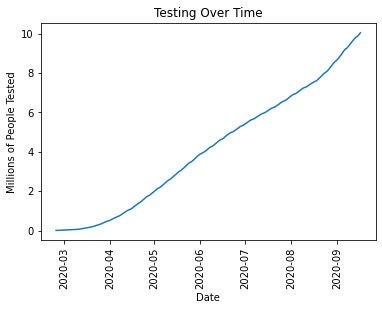

In [240]:
# Add code to plot the trend of the total number of people being tested as days progressed.
# X axis -> dates('Dates')
# Y axis -> number of people tested.('People_tested')

### STUDENT: Start of Code ###
fig = plt.figure()
graph1 = fig.add_subplot()

graph1.plot(date_format, data_orig['People_tested'] / 10**6)
graph1.set_xlabel('Date')
graph1.set_ylabel('Millions of People Tested')
graph1.set_title('Testing Over Time')

graph1.tick_params(axis='x', labelrotation=90)
### End of code ####

Graph 2: plot the total number of deaths for the entire period. Your X axis will be the dates ("Dates") and Y-axis will be the total number of death cases("Deaths") over the period of time.

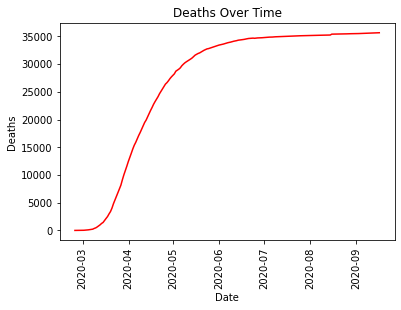

In [241]:
# Add code to plot the trend of total deaths as days progressed.
# X axis -> dates ('Dates')
# Y axis -> number of deaths ('Deaths')


### STUDENT: Start of Code ###
fig = plt.figure()
graph2 = fig.add_subplot()

graph2.plot(date_format, data_orig['Deaths'], color='red')
graph2.set_xlabel('Date')
graph2.set_ylabel('Deaths')
graph2.set_title('Deaths Over Time')
graph2.tick_params(axis='x', labelrotation=90)


plt.show()
### End of code ####

Graph 3: plot the total number of infected cases for the entire period. Your X axis will be the dates ("Dates") and Y-axis will be the total number of infected cases ('New_positive_cases') over the period of time.

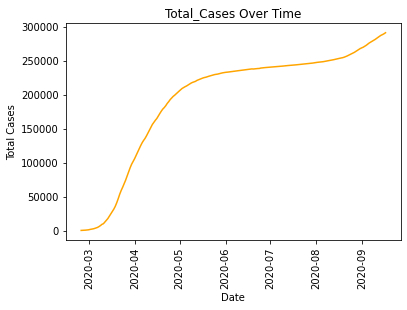

In [242]:
### STUDENT: Start of Code ###
fig = plt.figure()
graph3 = fig.add_subplot()

graph3.plot(date_format, data_orig['Total_cases'], color='orange')
graph3.set_xlabel('Date')
graph3.set_ylabel('Total Cases')
graph3.set_title('Total_Cases Over Time')
graph3.tick_params(axis='x', labelrotation=90)

plt.show()


### End of code ####

As we can see that our data has different ranges of values for every feature and this can cause problems in our model, so here we will normalize our data (ignoring the categorical variables) so that our data is scaled between 0 and 1. The downside, however, is that the numbers are no longer interpretable. To interpret it, you need to multiply back by the scaling factor.

**IMPORTANT: ** From now on, we will work with the normalized features to build the regression model. However, in **Task P8**, you need to convert the number back to the actual units.

In [243]:
data_list = data_orig.columns.values.tolist()

for i in data_list[-11:]:
    data[i]=(data_orig[i]-data_orig[i].min())/(data_orig[i].max()-data_orig[i].min())
    
data

,date,Country,hospitalized_with_symptom,Intensive_care,Total_hospitalized,Home_Isolation,Total_positive,Daily_change_in_positive_cases,New_positive_cases,Recovered,Deaths,Total_cases,People_tested
0,2020-02-24T18:00:00,ITA,0.000000,0.000000,0.000000,0.000000,0.000000,0.590051,0.022071,0.000000,0.000000,0.000000,0.000000
1,2020-02-25T18:00:00,ITA,0.000450,0.002227,0.000700,0.000814,0.000833,0.597704,0.002315,0.000000,0.000084,0.000319,0.000428
2,2020-02-26T18:00:00,ITA,0.000934,0.002474,0.001125,0.001520,0.001518,0.596344,0.000000,0.000009,0.000140,0.000587,0.000524
3,2020-02-27T18:00:00,ITA,0.005085,0.007422,0.005384,0.002274,0.003397,0.607313,0.026547,0.000204,0.000281,0.001446,0.000766
4,2020-02-28T18:00:00,ITA,0.008440,0.009401,0.008577,0.003806,0.005554,0.609864,0.024695,0.000209,0.000393,0.002263,0.001133
...,...,...,...,...,...,...,...,...,...,...,...,...,...
201,2020-09-12T17:00:00,ITA,0.063994,0.038595,0.061015,0.422174,0.345089,0.652636,0.219633,0.990365,0.998821,0.982333,0.970262
202,2020-09-13T17:00:00,ITA,0.067142,0.039832,0.063935,0.433064,0.354400,0.675595,0.212996,0.992423,0.999018,0.987332,0.977447
203,2020-09-14T17:00:00,ITA,0.069909,0.042306,0.066673,0.440101,0.360676,0.647704,0.143541,0.993891,0.999411,0.990794,0.981960
204,2020-09-15T17:00:00,ITA,0.073368,0.043295,0.069836,0.445140,0.365536,0.634694,0.177651,0.997120,0.999663,0.995014,0.989980


# Calculate the feature matrix

The following is a function that accepts a list of feature names (e.g. ['Total_Hospitalized', 'People_tested']) and an target feature e.g. ('Deaths') and returns two things:

1. A numpy matrix whose columns are the desired features plus a column with a constant value 1, which is also known as the 'intercept'.
2. A numpy array that contains the values of the target output.


In [244]:
def get_numpy_data(data_frame, features, output):
    # Steps
    # select the columns of data_Frame given by the features list into the variable features_sframe which will include the constant
    # Convert the features_frame into a numpy matrix
    # assign the column of data_frame associated with the output to the array output_array
    # convert the array into a numpy array by first converting it to a list
    # return feature_matrix,output_array
    
    data_frame['constant'] = 1 # here we are adding a constant column 
    # add the column 'constant' to the front of the features list.
    features = ['constant'] + features 
        
    # select the columns of data_Frame given by the features list into the variable features_sframe which will include the constant)
    features_frame = data_frame[features]
    
    # Convert the features_frame into a numpy matrix
    feature_matrix = features_frame.to_numpy()
    # print ("feature_matrix:", feature_matrix)
    
    # assign the column of data_frame associated with the output to the array output_array
    output_array = data_frame[output]
    
    # convert the array into a numpy array by first converting it to a list
    output_array = output_array.to_numpy()
    
    return(feature_matrix, output_array)    

For dates, we need to convert them into a sequence of numbers. We now add a new column to our dataframe corresponding to the number of days since the start of the dataset.

In [245]:
X = date_format
day_numbers = []
for i in range(1, len(X) + 1):
    day_numbers.append([i])
    
data['Days'] = pd.DataFrame(day_numbers,columns = ['Days'])
data["Days"] = data["Days"].astype(int)

Test the above function for a particular input and output feature.

In [246]:
(example_features, example_output) = get_numpy_data(data, ['Days'], 'New_positive_cases')
print (example_features[0,:]) 
print (example_output[0]) 

[1 1]
0.022071307300509338


# Predict the outputs with given regression weights

Suppose we had the weights $[1, 1]$ corresponding to the features $[1, 100]$, to compute the predicted output, we can simply take the dot product between them, so the output is $1*1 + 1*100 = 101$. Now, let's create the data with 

In [247]:
(test_features, output) = get_numpy_data(data, ['Days'], 'People_tested')

**Task P2:** Complete the following function  'predict_output'. Copy the the outputs of the code to the solution file.

In [248]:
def predict_output(feature_matrix, weights):
    # Inputs:
    # feature_matrix: a numpy matrix containing the features as columns (including the intercept), 
    #                 and each row corresponds to a data point
    # weights: a numpy array for the corresponding regression weights (including the intercept)
    # Output:
    # a numpy array that contains the predicted outputs (according to the provided weights) 
    # for all the data points in the feature_matrix
 
    # STUDENT: Start of code ####
    predictions = len(feature_matrix) * [0]
    
    for point_i in range(len(feature_matrix)):
        predictions[point_i] = np.dot(feature_matrix[point_i], weights)

    return np.array(predictions)
    ## end of code

In [249]:
# Copy the outputs of this code to the solution file
my_weights = np.array([1., 1.])
test_predictions = predict_output(example_features, my_weights)

print ("(normalized) prediction at day 5: ", test_predictions[5]) 
print ("(normalized) prediction at day 20 ", test_predictions[20])

(normalized) prediction at day 5:  7.0
(normalized) prediction at day 20  22.0


# Compute the derivative

We will now compute the derivative of the regression cost function: 
$$L_D(w) = \frac{1}{n}\sum_{i=1}^n (y_i-w\cdot x_i)^2,$$
where $x_i\in \mathrm{R}^d$ is the input feature of dimension $d$, $y_i\in\mathrm{R}$ is the output response, and $w\in\mathrm{R}^d$ is the regression weights.

**Task P3:** Complete the function 'weight_derivative' to calculate the derivative of the cost function with respect to regression weights $w$, i.e., $\frac{\partial}{\partial w}L_D(w)$. Note that this should be a $d$ dimensional vector. Also copy the output of the code for the test example to the solution file.

In [250]:
def weight_derivative(weights, feature_matrix, labels):
    # Input:
    # weights: weight vector w, a numpy vector of dimension d
    # feature_matrix: numpy array of size n by d, where n is the number of data points, and d is the feature dimension
    # labels: true labels y, a numpy vector of dimension d
    # Output:
    # Derivative of the regression cost function with respect to the weight w, a numpy array of dimension d

    # I wonder if there is a cleaner, faster way to do this with matrices
    # why am I so bad at math.


    ## STUDENT: Start of code ###
    derW = np.array([0] * len(weights))

    # we'll go through and add up the derivatives for each value
    for i in range(len(labels)):
        derW = derW + (labels[i] - np.dot(feature_matrix[i], weights)) * -2.0 * feature_matrix[i]  # I think this is the derivative for this one in particular
    derW /= len(labels) # take the average of the derivatives
    
    return derW
    # End of code ###

In [251]:
# NOTE: copy the output to the solution file.

(example_features, example_output) = get_numpy_data(data, ['Days'], 'People_tested') 
my_weights = np.array([0., 0.]) # this makes all the predictions 0
derivative = weight_derivative(my_weights, example_features,example_output)

print (derivative)

[  -0.82103242 -120.60087518]


# Gradient descent algorithm

Here, we will write a function to perform gradient descent algorithm on the lineare regression cost. Given an initial point, we will update the current weights by moving in the negative gradient direction to minimize the cost function. Thus, in each iteration we obtain the updated weight $w_{t+1}$ from the current iterate $w_t$ as follows:
$$w_{t+1} = w_t - h\frac{\partial}{\partial w}L_D(w_t),$$
where $h$ is the 'step_size' that is the amount by which we move in the negative gradient direction. 

We stop when we are sufficiently close to the optimum (where gradient is the zero vector) by checking the condition with respect to the magnitude (length) of the gradient vector:
$$\|\frac{\partial}{\partial w}L_D(w_t)\|_2\leq \epsilon,$$
where $\epsilon$ is the 'tolerance' parameter.

**Task P4:** Complete the code section to perform the gradient decent in the function `regression_gradient_descent`. Copy the code to the solution file.

In [252]:
def regression_gradient_descent(feature_matrix, labels, initial_weights, step_size, tolerance):
    # Gradient descent algorithm for linear regression problem    
    
    # Input:
    # feature_matrix: numpy array of size n by d, where n is the number of data points, and d is the feature dimension
    # labels: true labels y, a numpy vector of dimension d
    # initial_weights: initial weight vector to start with, a numpy vector of dimension d
    # step_size: step size of update
    # tolerance: tolerace epsilon for stopping condition
    # Output:
    # Weights obtained after convergence

    converged = False 
    weights = np.array(initial_weights) # current iterate
    i = 0
    while not converged:
        i += 1
        # STUDENT: Start of code: your impelementation of what the gradient descent algorithm does in every iteration
        # Refer back to the update rule listed above: update the weight
        gradient = weight_derivative(weights, feature_matrix, labels)

        weights = weights - step_size * gradient
        
        # Compute the gradient magnitude:
        gradient_magnitude = np.linalg.norm(gradient)
        
        # Check the stopping condition to decide whether you want to stop the iterations
        if gradient_magnitude <= tolerance:# STUDENT: check the stopping condition here
            converged = True
        # End of code
        
        print ("Iteration: ",i,"gradient_magnitude: ", gradient_magnitude) # for us to check about convergence
        
    return(weights)

# Use gradient descent for linear regression

Let's test the gradient descent algorithm for linear regression with a single feature ('Day'). Here we are using first 180 days' data as our training data.

In [253]:
#train_data
train_data = data[:180]

**Task P5:** Specify the initial_weights, step_size, and tolerance for the function `regression_gradient_descent`. Copy the outputs of the code to the solution file.


In [254]:
simple_features = ['Days']
my_output = 'People_tested'

# Use get_numpy_data method to calculate the feature matrix and output. 
(simple_feature_matrix, output) = get_numpy_data(train_data, simple_features, my_output)

#Initialize the weights, step size and tolerance
# Start of code
#STUDENT: Specify the initial_weights, step_size, and tolerance
initial_weights = np.array([0, 0])
step_size = .00005
tolerance = .01
# end of code

# Use the regression_gradient_descent function to calculate the gradient decent and store it in the variable 'final_weights'
final_weights = regression_gradient_descent(simple_feature_matrix, output, initial_weights, step_size, tolerance)

# end of code
print ("Here are the final weights after convergence:")
print (final_weights)

Iteration:  1 gradient_magnitude:  87.92653808664444
Iteration:  2 gradient_magnitude:  7.83369371554816
Iteration:  3 gradient_magnitude:  0.6996389112294757
Iteration:  4 gradient_magnitude:  0.07930694766069184
Iteration:  5 gradient_magnitude:  0.04953886790766123
Iteration:  6 gradient_magnitude:  0.049229427575151356
Iteration:  7 gradient_magnitude:  0.049225752979127735
Iteration:  8 gradient_magnitude:  0.04922451316591108
Iteration:  9 gradient_magnitude:  0.04922329270942886
Iteration:  10 gradient_magnitude:  0.04922207243660383
Iteration:  11 gradient_magnitude:  0.049220852195247584
Iteration:  12 gradient_magnitude:  0.04921963198415149
Iteration:  13 gradient_magnitude:  0.04921841180330509
Iteration:  14 gradient_magnitude:  0.04921719165270764
Iteration:  15 gradient_magnitude:  0.049215971532358356
Iteration:  16 gradient_magnitude:  0.049214751442256496
Iteration:  17 gradient_magnitude:  0.04921353138240136
Iteration:  18 gradient_magnitude:  0.049212311352792144
I

C:\Users\dwarf\AppData\Local\Temp\ipykernel_7200\2549809967.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_frame['constant'] = 1 # here we are adding a constant column


Iteration:  44 gradient_magnitude:  0.04918060119681858
Iteration:  45 gradient_magnitude:  0.04917938198356628
Iteration:  46 gradient_magnitude:  0.04917816280053873
Iteration:  47 gradient_magnitude:  0.04917694364773542
Iteration:  48 gradient_magnitude:  0.04917572452515567
Iteration:  49 gradient_magnitude:  0.049174505432798554
Iteration:  50 gradient_magnitude:  0.049173286370663344
Iteration:  51 gradient_magnitude:  0.04917206733874936
Iteration:  52 gradient_magnitude:  0.049170848337055845
Iteration:  53 gradient_magnitude:  0.049169629365581925
Iteration:  54 gradient_magnitude:  0.049168410424327076
Iteration:  55 gradient_magnitude:  0.04916719151329039
Iteration:  56 gradient_magnitude:  0.04916597263247122
Iteration:  57 gradient_magnitude:  0.049164753781868714
Iteration:  58 gradient_magnitude:  0.049163534961482104
Iteration:  59 gradient_magnitude:  0.04916231617131074
Iteration:  60 gradient_magnitude:  0.04916109741135384
Iteration:  61 gradient_magnitude:  0.049

**Task P6:** Use the learned weights to predict 'People_tested' in the last three weeks in the dataset. Copy the predictions to the solution file, and calculate the test error
$$\frac{1}{n_{\mathrm{tst}}}\sum_{i=1}^{n_{\mathrm{tst}}} (y_i^{\mathrm{tst}}-\hat{y}_i^{\mathrm{tst}})^2,$$
where $n_{\mathrm{tst}}$ is the number of test data, $y_i^{\mathrm{tst}}$ is the true label, $\hat{y}_i^{\mathrm{tst}}$ is the predicted label.

In [255]:
# Create the test data
test_data = data.iloc[-21:]
(test_simple_feature_matrix, test_output) = get_numpy_data(test_data, simple_features, my_output)
test_predictions = predict_output(test_simple_feature_matrix, final_weights)
print (test_predictions)

[0.79401501 0.79870914 0.80340327 0.80809741 0.81279154 0.81748567
 0.82217981 0.82687394 0.83156807 0.83626221 0.84095634 0.84565047
 0.85034461 0.85503874 0.85973287 0.86442701 0.86912114 0.87381527
 0.87850941 0.88320354 0.88789767]


C:\Users\dwarf\AppData\Local\Temp\ipykernel_7200\2549809967.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_frame['constant'] = 1 # here we are adding a constant column


In [256]:
# Calculate the test error
# STUDENT: Start of code
totalErr = 0

for i in range(len(test_output)):
    totalErr += (test_output[i] - test_predictions[i]) ** 2

totalErr /= len(test_output)

totalErr
#end of code

0.006100252963468465

# Linear regression using multiple features

Here, we will be considering multiple input features (`Intensive_care`,`New_positive_cases`,`Days`) to predict the `People_tested` in the future.

**Task P7:** Specify the initial_weights, step_size, and tolerance for the function `regression_gradient_descent`. Print the outputs of the code.


In [257]:
model_features = ['Intensive_care','New_positive_cases','Days'] 
my_output = 'People_tested'

#call the get_nupy_data method to calculate the feature matrix and output. Store them in the variables "multi_feature_matrix" & "output"

(multi_feature_matrix, output) = get_numpy_data(data, model_features, my_output)

# Initialize the weights, step size and tolerance
# STUDENT: Start of code
# STUDENT: Specify the initial_weights, step_size, and tolerance
initial_weights = [0, 0, 0, 0]
step_size = .000065
tolerance = .0025
# end of code
weight_2 = regression_gradient_descent(multi_feature_matrix, output, initial_weights, step_size, tolerance)
print ("Here are the final weights after convergence:")
print (weight_2)

Iteration:  1 gradient_magnitude:  120.60371726763957
Iteration:  2 gradient_magnitude:  102.80330349871325
Iteration:  3 gradient_magnitude:  87.63013051763261
Iteration:  4 gradient_magnitude:  74.6964327798152
Iteration:  5 gradient_magnitude:  63.6716767604822
Iteration:  6 gradient_magnitude:  54.27411384129441
Iteration:  7 gradient_magnitude:  46.263579943850026
Iteration:  8 gradient_magnitude:  39.43535789750767
Iteration:  9 gradient_magnitude:  33.61494568823261
Iteration:  10 gradient_magnitude:  28.65359688585554
Iteration:  11 gradient_magnitude:  24.424519280921416
Iteration:  12 gradient_magnitude:  20.81963458350702
Iteration:  13 gradient_magnitude:  17.746816374883082
Iteration:  14 gradient_magnitude:  15.127535725123646
Iteration:  15 gradient_magnitude:  12.894854308074702
Iteration:  16 gradient_magnitude:  10.99171372573284
Iteration:  17 gradient_magnitude:  9.369477324010475
Iteration:  18 gradient_magnitude:  7.986687234529291
Iteration:  19 gradient_magnitud

**Task P8:** Use the learned weights to predict 'People_tested' in the last three weeks in the dataset.Find the value of the model predictions on the 10th day of the forecasting period.Also print the actual number of people tested on that particular day. Copy the predictions to the solution file, and calculate the test error. Note: here we are asking you to report the number before normalization. So you need to convert the prediction back to the unit of people.

In [258]:
(test_feature_matrix, test_output) = get_numpy_data(test_data, model_features, my_output)

test_predictions_2 = predict_output(test_feature_matrix, weight_2)

#Prediction for the 10th day of the forecasting period.
print (test_predictions_2[10])

#Convert the normalized data back to original figures using the same min-max normalization
prediction_10th_day = test_predictions_2[10] * (data_orig['People_tested'].max() - data_orig['People_tested'].min()) + data_orig['People_tested'].min()

print ("Model prediction of the 10th day:",int(prediction_10th_day))

# Get the actual number of people tested from our test data on 10 th day of forecasting period.
actual_people_tested = data_orig["People_tested"].iloc[190]

print ("Actual number of people tested on the 10th day:",actual_people_tested)


0.865972411539274
Model prediction of the 10th day: 8698883
Actual number of people tested on the 10th day: 8725909


C:\Users\dwarf\AppData\Local\Temp\ipykernel_7200\2549809967.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_frame['constant'] = 1 # here we are adding a constant column


In [259]:
# Calculate the test error
# STUDENT: Start of code

totalErr = 0

for i in range(len(test_output)):
    totalErr += (test_output[i] - test_predictions_2[i]) ** 2

totalErr /= len(test_output)

totalErr
# end of code

0.003042188973265251

# Explore on your own

Now that you have tried two models for predictions, in this section, you can explore on your own an aspect of the problem that interests you. Here are some examples:
* What features or what combination of features are most predictive for 'People_tested'?
* How does tolerance for convergence affect prediction errors?
* How does step size affect prediction errors?
* How can we use validation to select the set of features to improve prediction?

Report your question of investigation, as well as your results/interpretation in the solution file.

C:\Users\dwarf\AppData\Local\Temp\ipykernel_7200\2549809967.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_frame['constant'] = 1 # here we are adding a constant column


Iteration:  1 gradient_magnitude:  120.60371726763957
Iteration:  2 gradient_magnitude:  51.86313969459443
Iteration:  3 gradient_magnitude:  22.302752548900123
Iteration:  4 gradient_magnitude:  9.59105787715702
Iteration:  5 gradient_magnitude:  4.1249613952301125
Iteration:  6 gradient_magnitude:  1.7750808953369075
Iteration:  7 gradient_magnitude:  0.766185075352217
Iteration:  8 gradient_magnitude:  0.3360288741327787
Iteration:  9 gradient_magnitude:  0.15886432361110572
Iteration:  10 gradient_magnitude:  0.09499456945740599
Iteration:  11 gradient_magnitude:  0.07762390619570612
Iteration:  12 gradient_magnitude:  0.07396507318905005
Iteration:  13 gradient_magnitude:  0.07326748079727465
Iteration:  14 gradient_magnitude:  0.07313678045415488
Iteration:  15 gradient_magnitude:  0.07311161567678874
Iteration:  16 gradient_magnitude:  0.07310599166565118
Iteration:  17 gradient_magnitude:  0.0731039821363755
Iteration:  18 gradient_magnitude:  0.07310264107014695
Iteration:  19

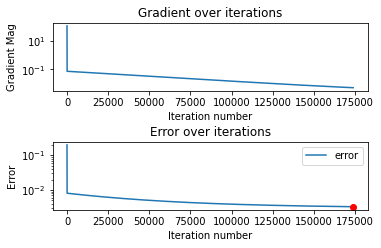

Minimum Error: 0.003309
Final Error: 0.003309
Final weights: 
[-0.06523202 -0.04754838 -0.02634819  0.00476995]


In [260]:
# Explore an aspect of the model that interests you
### STUDENT: Start of code

# What is the relationship between convergence tolerance and prediction error?

# I am curious about the effect of step size on error and its corellation with tolerance

prediction_errors = list()
theory_tolerance = list()

# I am going to use the feature set I just used

model_features = ['Intensive_care','New_positive_cases','Days'] 
my_output = 'People_tested'

#call the get_nupy_data method to calculate the feature matrix and output. Store them in the variables "multi_feature_matrix" & "output"

(multi_feature_matrix, output) = get_numpy_data(data, model_features, my_output)
(test_feature_matrix, test_output) = get_numpy_data(test_data, model_features, my_output)

# Initialize the weights, step size and tolerance
# STUDENT: Start of code
# STUDENT: Specify the initial_weights, step_size, and tolerance
initial_weights = [0, 0, 0, 0]
step_size = .00002
tolerance = .005

# now I will do the regression but keep track of the values at each stage
weights = initial_weights
converged = False 
i = 0 # this is the current iteration

minError = 1
minErrorI = 0

while not converged:
    i += 1
    # STUDENT: Start of code: your impelementation of what the gradient descent algorithm does in every iteration
    # Refer back to the update rule listed above: update the weight
    gradient = weight_derivative(weights, multi_feature_matrix, output)

    weights = weights - step_size * gradient
    
    # Compute the gradient magnitude:
    gradient_magnitude = np.linalg.norm(gradient)
    
    print ("Iteration: ",i,"gradient_magnitude: ", gradient_magnitude) # for us to check about convergence

    # now I will cacululate the current prediction errors and add everything to the current tolerance
    theory_tolerance.append(gradient_magnitude)

    totalErr = 0
    test_predictions_2 = predict_output(test_feature_matrix, weights)

    for b in range(len(test_output)):
        totalErr += (test_output[b] - test_predictions_2[b]) ** 2

    totalErr /= len(test_output)

    prediction_errors.append(totalErr)

    if totalErr < minError:
        minError = totalErr
        minErrorI = i - 1

    # Check the stopping condition to decide whether you want to stop the iterations
    if gradient_magnitude <= tolerance:# STUDENT: check the stopping condition here
        converged = True


figure, axis = plt.subplots(2, 1)

figure.tight_layout(h_pad=3, pad=4)

axis[0].plot(range(len(theory_tolerance)), theory_tolerance, label = 'tolerance')
axis[0].set_yscale('log')
axis[0].set_title('Gradient over iterations')
axis[0].set_xlabel('Iteration number')
axis[0].set_ylabel('Gradient Mag')


axis[1].plot(range(len(prediction_errors)), prediction_errors, label='error')
axis[1].plot(minErrorI, minError, 'ro')
axis[1].set_yscale('log')
axis[1].set_title('Error over iterations')
axis[1].set_xlabel('Iteration number')
axis[1].set_ylabel('Error')

plt.legend()
plt.show()
#figure.savefig('tol-and-err2.jpg')

print('Minimum Error: {:f}'.format(minError))
print('Final Error: {:f}'.format(prediction_errors[-1]))
print('Final weights: ')
print(weights)

### End of code